In [2]:
# !pip install torchview
# !pip install torchviz

In [3]:
import pandas as pd
import numpy as np
import csv
import torch
import ctypes
import gc
libc = ctypes.CDLL("libc.so.6")

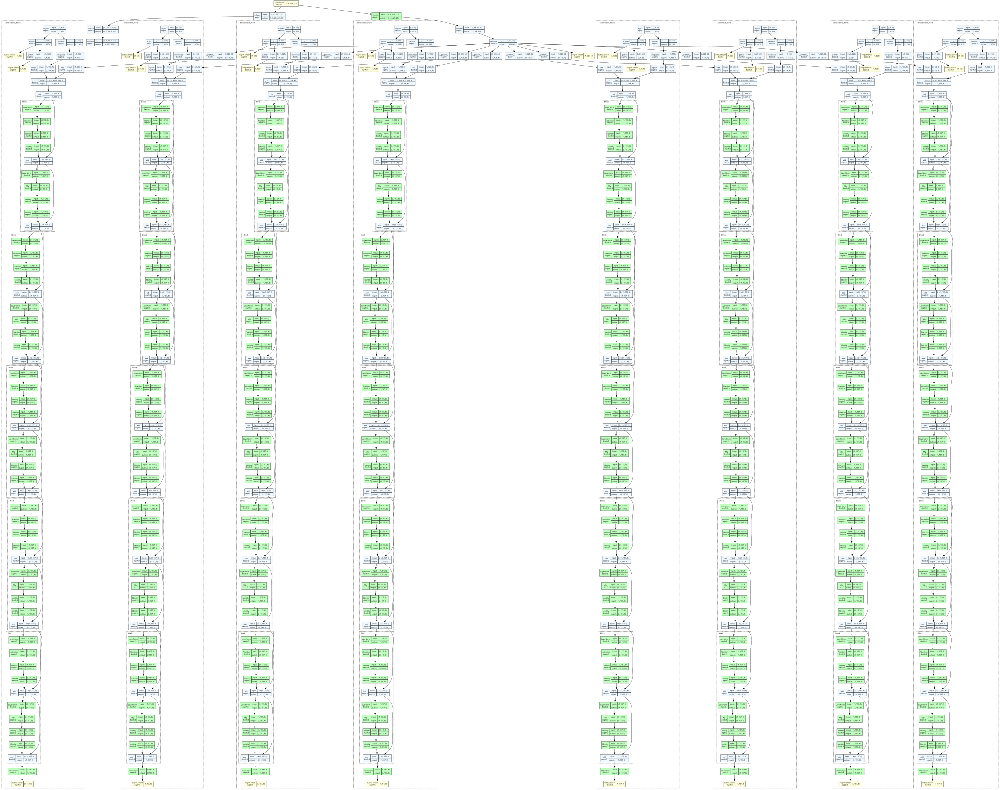

In [3]:
import numpy as np

import torch

def get_2d_sincos_pos_embed(embed_dim, grid_size, cls_token=False):
    """
    grid_size: int of the grid height and width
    return:
    pos_embed: [grid_size*grid_size, embed_dim] or [1+grid_size*grid_size, embed_dim] (w/ or w/o cls_token)
    """
    grid_h = np.arange(grid_size, dtype=np.float32)
    grid_w = np.arange(grid_size, dtype=np.float32)
    grid = np.meshgrid(grid_w, grid_h)  # here w goes first
    grid = np.stack(grid, axis=0)

    grid = grid.reshape([2, 1, grid_size, grid_size])
    pos_embed = get_2d_sincos_pos_embed_from_grid(embed_dim, grid)
    if cls_token:
        pos_embed = np.concatenate([np.zeros([1, embed_dim]), pos_embed], axis=0)
    return pos_embed


def get_2d_sincos_pos_embed_from_grid(embed_dim, grid):
    assert embed_dim % 2 == 0

    # use half of dimensions to encode grid_h
    emb_h = get_1d_sincos_pos_embed_from_grid(embed_dim // 2, grid[0])  # (H*W, D/2)
    emb_w = get_1d_sincos_pos_embed_from_grid(embed_dim // 2, grid[1])  # (H*W, D/2)

    emb = np.concatenate([emb_h, emb_w], axis=1) # (H*W, D)
    return emb


def get_1d_sincos_pos_embed_from_grid(embed_dim, pos):
    """
    embed_dim: output dimension for each position
    pos: a list of positions to be encoded: size (M,)
    out: (M, D)
    """
    assert embed_dim % 2 == 0
    omega = np.arange(embed_dim // 2, dtype='float32')
    omega /= embed_dim / 2.
    omega = 1. / 10000**omega  # (D/2,)

    pos = pos.reshape(-1)  # (M,)
    out = np.einsum('m,d->md', pos, omega)  # (M, D/2), outer product

    emb_sin = np.sin(out) # (M, D/2)
    emb_cos = np.cos(out) # (M, D/2)

    emb = np.concatenate([emb_sin, emb_cos], axis=1)  # (M, D)
    return emb

from functools import partial

import torch
import torch.nn as nn

from timm.models.vision_transformer import PatchEmbed, Block

class Transformer_block(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=8,mask_ratio = 0.75,
                 embed_dim=1024, depth=24, num_heads=16,
                 mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False):
        super().__init__()

        # --------------------------------------------------------------------------
        # MAE encoder specifics
        self.patch_embed = PatchEmbed(img_size, patch_size, in_chans, embed_dim)
        self.mask_ratio = mask_ratio
        num_patches = self.patch_embed.num_patches
        
        self.cls_token = nn.Parameter(torch.zeros(1, 1, embed_dim))
        self.pos_embed = nn.Parameter(torch.zeros(1, num_patches + 1, embed_dim), requires_grad=False)  # fixed sin-cos embedding

        self.blocks = nn.ModuleList([
            Block(embed_dim, num_heads, mlp_ratio, qkv_bias=True, norm_layer=norm_layer)
            for i in range(depth)])
        
        self.norm = norm_layer(embed_dim)

        self.initialize_weights()
        

    def initialize_weights(self):
        # initialization
        # initialize (and freeze) pos_embed by sin-cos embedding
        pos_embed = get_2d_sincos_pos_embed(self.pos_embed.shape[-1], int(self.patch_embed.num_patches**.5), cls_token=True)
        self.pos_embed.data.copy_(torch.from_numpy(pos_embed).float().unsqueeze(0))

        # initialize patch_embed like nn.Linear (instead of nn.Conv2d)
        w = self.patch_embed.proj.weight.data
        torch.nn.init.xavier_uniform_(w.view([w.shape[0], -1]))

        # timm's trunc_normal_(std=.02) is effectively normal_(std=0.02) as cutoff is too big (2.)
        torch.nn.init.normal_(self.cls_token, std=.02)

        # initialize nn.Linear and nn.LayerNorm
        self.apply(self._init_weights)
    
    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            # we use xavier_uniform following official JAX ViT:
            torch.nn.init.xavier_uniform_(m.weight)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            nn.init.constant_(m.bias, 0)
            nn.init.constant_(m.weight, 1.0)
        
    def patchify(self, imgs):
        """
        imgs: (N, 8, H, W)
        x: (N, L, patch_size**2 *3)
        """
        p = self.patch_embed.patch_size[0]
        assert imgs.shape[2] == imgs.shape[3] and imgs.shape[2] % p == 0

        h = w = imgs.shape[2] // p
        x = imgs.reshape(shape=(imgs.shape[0], 8, h, p, w, p))
        x = torch.einsum('nchpwq->nhwpqc', x)
        x = x.reshape(shape=(imgs.shape[0], h * w, p**2 * 8))
        return x

    def unpatchify(self, x):
        """
        x: (N, L, patch_size**2 *3)
        imgs: (N, 8, H, W)
        """
        p = self.patch_embed.patch_size[0]
        h = w = int(x.shape[1]**.5)
        assert h * w == x.shape[1]
        
        x = x.reshape(shape=(x.shape[0], h, w, p, p, 8))
        x = torch.einsum('nhwpqc->nchpwq', x)
        imgs = x.reshape(shape=(x.shape[0], 8, h * p, h * p))
        return imgs

    def random_masking(self, x, mask_ratio):
        """
        Perform per-sample random masking by per-sample shuffling.
        Per-sample shuffling is done by argsort random noise.
        x: [N, L, D], sequence
        """
        N, L, D = x.shape  # batch, length, dim
        len_keep = int(L * (1 - mask_ratio))
        
        noise = torch.rand(N, L, device=x.device)  # noise in [0, 1]
        
        # sort noise for each sample
        ids_shuffle = torch.argsort(noise, dim=1)  # ascend: small is keep, large is remove
        ids_restore = torch.argsort(ids_shuffle, dim=1)

        # keep the first subset
        ids_keep = ids_shuffle[:, :len_keep]
        x_masked = torch.gather(x, dim=1, index=ids_keep.unsqueeze(-1).repeat(1, 1, D))

        # generate the binary mask: 0 is keep, 1 is remove
        mask = torch.ones([N, L], device=x.device)
        mask[:, :len_keep] = 0
        # unshuffle to get the binary mask
        mask = torch.gather(mask, dim=1, index=ids_restore)

        return x_masked, mask, ids_restore
    
    def forward(self, x):

        # add pos embed w/o cls token
        x = x + self.pos_embed[:, 1:, :]

        # masking: length -> length * mask_ratio
        x, mask, ids_restore = self.random_masking(x, self.mask_ratio)

        # append cls token
        cls_token = self.cls_token + self.pos_embed[:, :1, :]
        cls_tokens = cls_token.expand(x.shape[0], -1, -1)
        x = torch.cat((cls_tokens, x), dim=1)

        # apply Transformer blocks
        for blk in self.blocks:
            x = blk(x)
        x = self.norm(x)
        
        return x, mask, ids_restore
    
class Encoder(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=8,mask_ratio = 0.75,
                 embed_dim=1024, depth=24, num_heads=16,k_factor = 32,
                 mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False):
        super().__init__()
        
        self.patch_embed = nn.Conv2d(
            in_channels=8, groups=8, out_channels=8*k_factor, kernel_size=patch_size, stride=patch_size
        )
        
        self.blocks = nn.ModuleList([
            Transformer_block(img_size=img_size, patch_size=patch_size, in_chans=1,mask_ratio = mask_ratio,
                 embed_dim=embed_dim, depth=depth, num_heads=num_heads,
                 mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False)
            for _ in range(8)
        ])

        
    def _preprocess(self, x):
        batch_size, embed_dim, n_h, n_w = x.shape
        x = x.reshape(batch_size, embed_dim, n_h*n_w)
        x = x.permute(0,2,1)
        return x
        
    def forward(self, x):
        encoded_tensor = []
        masks = []
        ids = []
        imgs = []
        
        conv_proj = self._preprocess(self.patch_embed(x))
        batch_size, seq_len, encoded_latent_size = conv_proj.shape
        encoded_latent_size_per_channel = encoded_latent_size//8
        
        for i in range(8):
            encoded_latent = conv_proj[:,:,i*encoded_latent_size_per_channel:(i+1)*encoded_latent_size_per_channel]
            op, mask, ids_restore = self.blocks[i](encoded_latent)
            encoded_tensor.append(op)
            masks.append(mask)
            ids.append(ids_restore)
            # imgs.append(self.blocks[0].patch_embed(x[:,i,:,:].unsqueeze(1)))
        # img = torch.cat(imgs, axis = 2)
        img = self.blocks[0].patchify(x)
        
        return encoded_tensor, masks, ids, conv_proj
    
import torchvision
from torchview import draw_graph
from torchviz import make_dot
encoder = Encoder(
    img_size=125, patch_size=5, in_chans = 1,k_factor = 8, embed_dim=8, depth=5, num_heads=8,mask_ratio = 0.75,
    mlp_ratio=4, norm_layer=partial(nn.LayerNorm, eps=1e-6))

model_graph = draw_graph(encoder, input_size=(1,8,125,125), expand_nested=True)
model_graph.visual_graph

In [4]:
# class upsample(nn.Module):
#     def __init__(self, patch_size, in_chans):
#         self.conv_proj = nn.ConvTranspose2d(in_channels=96*8, out_channels=8, kernel_size=patch_size, stride = patch_size)
        
class Decoder_transformer_block(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=8,
                 embed_dim=1024, depth=24, num_heads=16,
                 decoder_embed_dim=512, decoder_depth=8, decoder_num_heads=16,
                 mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False):
        super().__init__()

        self.num_patches = (img_size//patch_size)**2
        self.decoder_embed = nn.Linear(embed_dim, decoder_embed_dim, bias=True)

        self.mask_token = nn.Parameter(torch.zeros(1, 1, decoder_embed_dim))

        self.decoder_pos_embed = nn.Parameter(torch.zeros(1, self.num_patches + 1, decoder_embed_dim), requires_grad=False)  # fixed sin-cos embedding

        self.decoder_blocks = nn.ModuleList([
            Block(decoder_embed_dim, decoder_num_heads, mlp_ratio, qkv_bias=True, norm_layer=norm_layer)
            for i in range(decoder_depth)])

        self.decoder_norm = norm_layer(decoder_embed_dim)
        self.decoder_pred = nn.Linear(decoder_embed_dim, patch_size**2 * 8, bias=True) # decoder to patch
        # --------------------------------------------------------------------------

        self.norm_pix_loss = norm_pix_loss

        self.initialize_weights()

    def initialize_weights(self):
        # initialization
        # initialize (and freeze) pos_embed by sin-cos embedding

        decoder_pos_embed = get_2d_sincos_pos_embed(self.decoder_pos_embed.shape[-1], int(self.num_patches**.5), cls_token=True)
        self.decoder_pos_embed.data.copy_(torch.from_numpy(decoder_pos_embed).float().unsqueeze(0))

        # timm's trunc_normal_(std=.02) is effectively normal_(std=0.02) as cutoff is too big (2.)
        torch.nn.init.normal_(self.mask_token, std=.02)

        # initialize nn.Linear and nn.LayerNorm
        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            # we use xavier_uniform following official JAX ViT:
            torch.nn.init.xavier_uniform_(m.weight)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.LayerNorm):
            nn.init.constant_(m.bias, 0)
            nn.init.constant_(m.weight, 1.0)

    def patchify(self, imgs):
        """
        imgs: (N, 8, H, W)
        x: (N, L, patch_size**2 *3)
        """
        p = self.patch_embed.patch_size[0]
        assert imgs.shape[2] == imgs.shape[3] and imgs.shape[2] % p == 0

        h = w = imgs.shape[2] // p
        x = imgs.reshape(shape=(imgs.shape[0], 8, h, p, w, p))
        x = torch.einsum('nchpwq->nhwpqc', x)
        x = x.reshape(shape=(imgs.shape[0], h * w, p**2 * 8))
        return x

    def forward(self, x):
        # embed tokens
        x = self.decoder_embed(x)

        # add pos embed
        x = x + self.decoder_pos_embed

        # apply Transformer blocks
        for blk in self.decoder_blocks:
            x = blk(x)
        x = self.decoder_norm(x)

        return x
    
class Decoder_block(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=8,embed_dim=1024,
             decoder_embed_dim=25, decoder_depth=8, decoder_num_heads=16,
             mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False):
        super().__init__()

        self.decoder_depth = decoder_depth
        self.block = nn.ModuleList([Decoder_transformer_block(img_size=img_size, patch_size=patch_size, in_chans=in_chans,
                                                 embed_dim=decoder_embed_dim[i],decoder_embed_dim=decoder_embed_dim[i], 
                                                 decoder_num_heads=decoder_num_heads[i], mlp_ratio=4., decoder_depth=1,
                                                 norm_layer=nn.LayerNorm, norm_pix_loss=False) for i in range(decoder_depth-1)])
        
        self.linear_layer = nn.ModuleList([nn.Linear(in_features = decoder_embed_dim[i], out_features = decoder_embed_dim[i+1]) for i in range(decoder_depth-2)])
        
        self.mask_token = nn.Parameter(torch.zeros(1, 1, embed_dim))
        
    def forward(self, x, ids):
        
        mask_tokens = self.mask_token.repeat(x.shape[0], ids.shape[1] + 1 - x.shape[1], 1)
        x_ = torch.cat([x[:, 1:, :], mask_tokens], dim=1)  # no cls token
        cls_token = (x[:,:1,:])
        x_ = torch.gather(x_, dim=1, index=ids.unsqueeze(-1).repeat(1, 1, x.shape[2]))  # unshuffle

        op = torch.cat([cls_token, x_], dim=1)

        for i in range(self.decoder_depth-2):
            op = self.block[i](op)
            op = self.linear_layer[i](op)
            
        op = self.block[self.decoder_depth-2](op)
            
        return op

class Decoder(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=8,
             embed_dim=1024, depth=24, num_heads=16,
             decoder_embed_dim=None, decoder_depth=8, decoder_num_heads=[8,8,8,8,8],
             mlp_ratio=4., norm_layer=nn.LayerNorm, norm_pix_loss=False):
        super().__init__()
        
        self.patch_size = patch_size
        self.decoder_depth = decoder_depth
        self.block = nn.ModuleList([Decoder_block(img_size=125, patch_size=patch_size, embed_dim=embed_dim,in_chans = 1,
                                    decoder_embed_dim=decoder_embed_dim, decoder_depth=decoder_depth, decoder_num_heads=decoder_num_heads,
                                    mlp_ratio=mlp_ratio, norm_layer=norm_layer) for _ in range(8)])
                 
        self.linear = nn.Linear(in_features = 24, out_features = 25)
        
    def unpatchify(self, x):
        """
        x: (N, L, patch_size**2 *8)
        imgs: (N, 8, H, W)
        """
#         print(x.shape)
        p = self.patch_size
        h = w = int(x.shape[1]**.5)
        assert h * w == x.shape[1]
        
        x = x.reshape(shape=(x.shape[0], h, w, p, p, 1))
        x = torch.einsum('nhwpqc->nchpwq', x)
        imgs = x.reshape(shape=(x.shape[0], 1, h * p, h * p))
        return imgs
    
    def forward(self, x, ids):
        op = []
        for i in range(8):
            lo = self.block[i](x[i], ids[i])
            lo = self.linear(lo)
            lo = self.unpatchify(lo[:,1:,:])
            op.append(lo)
        return op


In [5]:
  
class Masked_VIT(nn.Module):
    def __init__(self, encoder, decoder, mask_ratio):
        super().__init__()
        
        self.encoder = encoder
        self.decoder = decoder
        self.mask_ratio = mask_ratio
        
    def forward(self, x):
        encoded_tensor, mask, ids_restore, patchified_img = self.encoder(x)
        pred = self.decoder(encoded_tensor, ids_restore)
        
        return pred, mask
    
def mae_vit_base_patch16_dec512d8b(mask_ratio = 0.75, **kwargs):
    encoder = Encoder(
        img_size=125, mask_ratio = mask_ratio, patch_size=5, embed_dim=8,k_factor = 8, depth=6, num_heads=8,in_chans = 1,
        mlp_ratio=4, norm_layer=partial(nn.LayerNorm, eps=1e-6), **kwargs)
    
    decoder = Decoder(
        img_size=125, patch_size=5, embed_dim=8, in_chans = 1,
        decoder_embed_dim=[8, 12, 16, 20, 24], decoder_depth=6, decoder_num_heads=[8,6,8,5,8],
        mlp_ratio=4, norm_layer=partial(nn.LayerNorm, eps=1e-6), **kwargs)
    
    model = Masked_VIT(encoder, decoder, mask_ratio)
    
    return model

# Instantiate the model
model = mae_vit_base_patch16_dec512d8b(mask_ratio = 0.75)

In [6]:
# from timm.models.vision_transformer import PatchEmbed, Block??

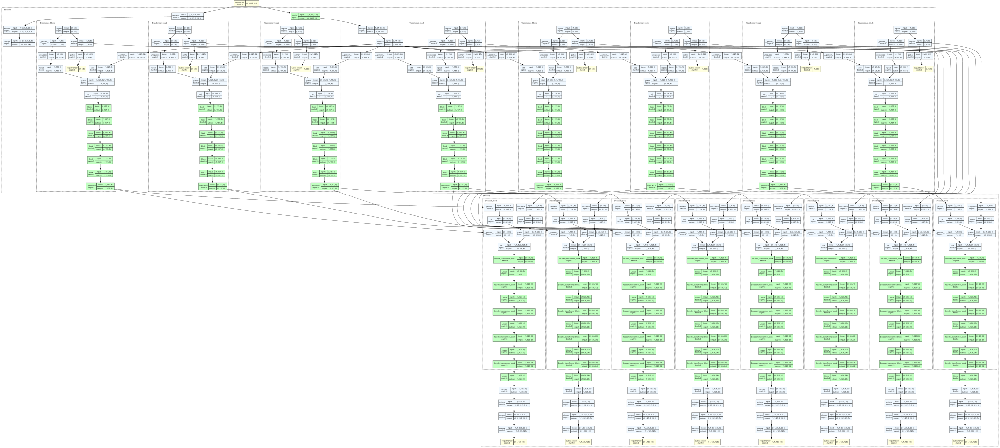

In [7]:
import torchvision
from torchview import draw_graph
from torchviz import make_dot

model_graph = draw_graph(model, input_size=(1,8,125,125), expand_nested=True)
model_graph.visual_graph

In [8]:
import os
print(os.listdir("/kaggle/input/"))

X_train = np.load('/kaggle/input/train_dataset.npy')

X_train.shape

X_test = np.load('/kaggle/input/test_dataset.npy')

X_test.shape
X_train /=255.0
X_test /=255.0

['train_dataset.npy', 'test_dataset.npy']


In [9]:
import os
import torch
import pandas as pd
# from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

class Custom_Dataset(Dataset):
    def __init__(self, x):
        self.x = x
        
    def __len__(self):
        return len(self.x)
    
    def __getitem__(self,idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        img_1 = torch.from_numpy(self.x[idx]).moveaxis(2, 0)
        sample = {'img' : img_1}
        
        return sample
dataset = Custom_Dataset(X_train)
sample = dataset.__getitem__(0)
inp = []
inp.append(dataset.__getitem__(0)['img'].unsqueeze(0))
inp.append(dataset.__getitem__(1)['img'].unsqueeze(0))
inp = torch.cat(inp, axis = 0)
print("X_train shape:", X_train.shape)
print("Sample image shape:", sample['img'].shape)
print("Sample image values:", sample['img'].max())

X_train shape: (32000, 125, 125, 8)
Sample image shape: torch.Size([8, 125, 125])
Sample image values: tensor(1.)


In [10]:
pred, mask = model(inp.to('cuda'))

In [11]:
inp.shape

torch.Size([2, 8, 125, 125])

In [12]:
pred[0].shape

torch.Size([2, 1, 125, 125])

In [13]:
import numpy as np
import torch

# def custom_loss(imgs, pred, mask):

#     L = 0
#     for i in range(len(mask)):
#         l = ((pred[:, : ,i, :] - imgs[:, : ,i, :])**2).unsqueeze(axis = 2).mean(axis = -1)
#         # Move the mask tensor to the CPU before converting it to a NumPy array
#         mask_cpu = mask[i].unsqueeze(axis = -1)
#         loss = (l * mask_cpu).sum()
#         L+=((loss / mask_cpu.sum()))
    
#     return L/8
def bcelogitsloss(output, labels):
    criterion = nn.BCEWithLogitsLoss(reduction = 'mean')
    loss = 0
    output = torch.cat(output, axis = 1)
#     for i in range(8):
#         op = output[i].squeeze(1)
#         print(op.shape)
#         lab = labels[:, i,:,:].to('cuda')
#         loss += criterion(op, lab)
    loss+=criterion(output, labels)
    return loss

# print(bcelogitsloss(pred, inp))

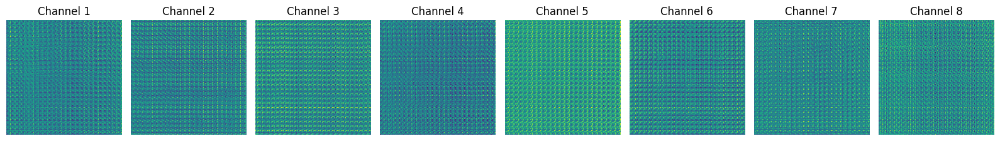

In [14]:
def reduce_fn(vals):
    # take average
    # xm.print(len(vals))
    return sum(vals) / len(vals)

def visualize_prediction(pred):
    # Reshape prediction for visualization
    # preds = pred.reshape((pred.shape[0], 625, 200))

    def unpatchify(x):
        """
        x: (N, L, patch_size**2 * 3)
        imgs: (N, 8, H, W)
        """
        p = 5
        h = w = int(x.shape[1]**0.5)
        assert h * w == x.shape[1]
        
        x = x.reshape((x.shape[0], h, w, p, p, 8))
        x = torch.einsum('nhwpqc->nchpwq', x)
        imgs = x.reshape((x.shape[0], 8, h * p, w * p))
        return imgs

    # Unpatchify the prediction
#     preds = unpatchify(pred)[0]
    preds = torch.cat(pred, axis = 1)
    preds = preds[0]

    # Convert to numpy array and move to CPU if necessary
    img = preds.permute(1, 2, 0).cpu().detach().numpy()

    # Number of channels
    num_channels = img.shape[2]

    # Create a single row of subplots
    fig, axes = plt.subplots(1, num_channels, figsize=(16, 4))

    # Iterate through channels and plot each one in a subplot
    for i in range(num_channels):
        axes[i].imshow(img[:,:,i])  # Adjust colormap as needed
        axes[i].set_title(f'Channel {i+1}')
        axes[i].axis('off')  # Turn off axis labels

    plt.tight_layout()
    plt.show()
# preds = torch.cat(pred, axis = 1)
# print(preds.shape)
visualize_prediction(pred)

In [15]:
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from torch.optim import AdamW
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts
import torch.nn as nn
import tqdm
from tqdm import tqdm
from torchmetrics import Accuracy

# Define your Custom_Dataset class here (assuming it's defined earlier)

# Define your MaskedAutoencoderViT class here (assuming it's defined earlier)

def model_train(model, epochs, train_dataloader, val_dataloader, device):
#     criterion = custom_loss()
    optimizer = AdamW(model.parameters(), lr=1.5e-4, weight_decay=0.05)
    scheduler = CosineAnnealingWarmRestarts(optimizer, T_0=40, T_mult=2)

    train_losses = []
    val_losses = []

    for epoch in range(epochs):
        train_loss = 0.0
        val_loss = 0.0

        model.train()
        for batch in tqdm(train_dataloader, desc=f'Epoch {epoch+1}/{epochs} (Train)', unit='batch'):
            images = batch['img'].to(device)

            optimizer.zero_grad()
            outputs, mask = model(images)
            loss = bcelogitsloss(outputs, images)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()

        train_loss /= len(train_dataloader)
        train_losses.append(train_loss)

        original_image = None
        reconstructed_image = None
        
        model.eval()
        with torch.no_grad():
            for batch in tqdm(val_dataloader, desc=f'Epoch {epoch+1}/{epochs} (Val)', unit='batch'):
                images = batch['img'].to(device).float()
                outputs, mask= model(images)

                loss = bcelogitsloss(outputs, images)
                val_loss += loss.item()

        val_loss /= len(val_dataloader)
        val_losses.append(val_loss)

        scheduler.step()
        visualize_prediction(outputs)
#         channel_wise_visualization(original_image[0], reconstructed_image[0])

        print(f'Epoch {epoch+1}/{epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')
        with open('losses.txt', 'a') as f:  # Open file in append mode
            f.write(f'Epoch {epoch+1}/{epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}\n')
    
        torch.save(model.module.state_dict(), f'./full_model.pth')
    
    return train_losses, val_losses

# Assuming dataset, train_dataloader, and val_dataloader are defined earlier

# Define your model
# del model
gc.collect()
torch.cuda.empty_cache()

In [16]:
del model
gc.collect()
torch.cuda.empty_cache()

In [17]:
model = mae_vit_base_patch16_dec512d8b(mask_ratio = 0.75)

In [18]:
train_dataset = Custom_Dataset(X_train)
test_dataset = Custom_Dataset(X_test)
training_loss = []
validation_loss = []
# Create data loaders
train_dataloader = DataLoader(train_dataset, batch_size=512, shuffle=True)
val_dataloader = DataLoader(test_dataset, batch_size=512, shuffle=False)

DEVICE = torch.torch.device("cuda")
NUM_GPU = torch.cuda.device_count()
if NUM_GPU > 1:
    model = nn.DataParallel(model)
model = model.to(DEVICE)

Epoch 1/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


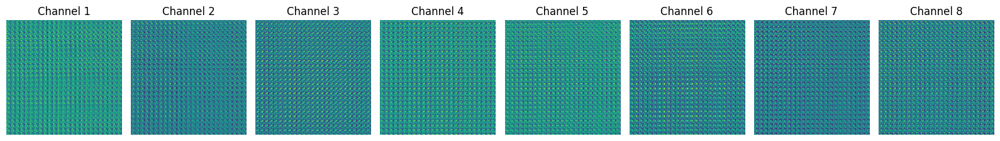

Epoch 1/40, Train Loss: 0.6031, Val Loss: 0.4927


Epoch 2/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.34s/batch]


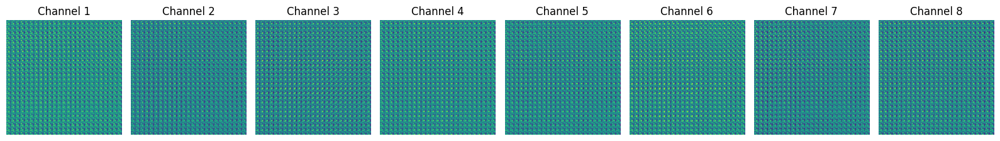

Epoch 2/40, Train Loss: 0.4268, Val Loss: 0.3718


Epoch 3/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


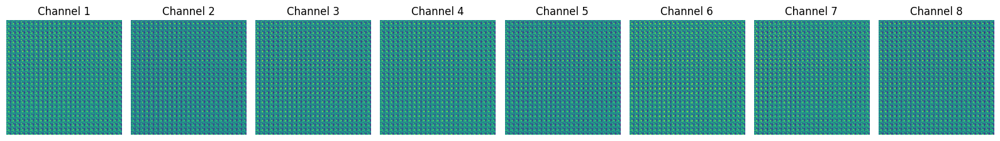

Epoch 3/40, Train Loss: 0.3334, Val Loss: 0.2988


Epoch 4/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


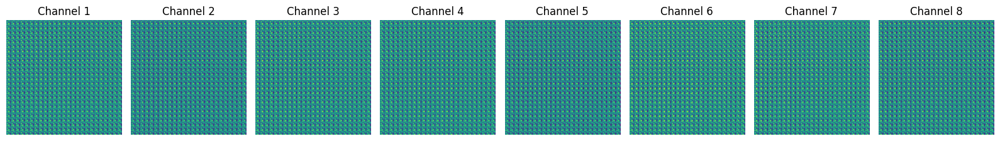

Epoch 4/40, Train Loss: 0.2709, Val Loss: 0.2451


Epoch 5/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


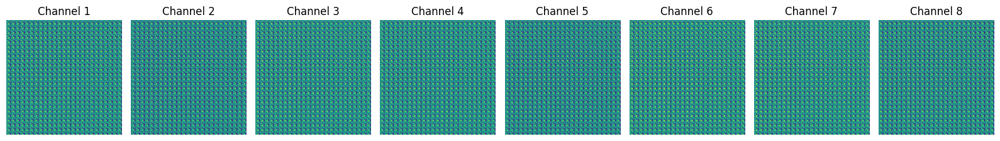

Epoch 5/40, Train Loss: 0.2235, Val Loss: 0.2035


Epoch 6/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


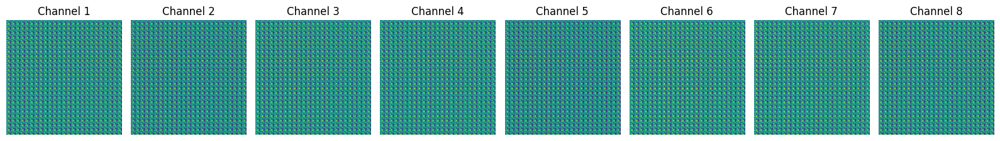

Epoch 6/40, Train Loss: 0.1864, Val Loss: 0.1709


Epoch 7/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


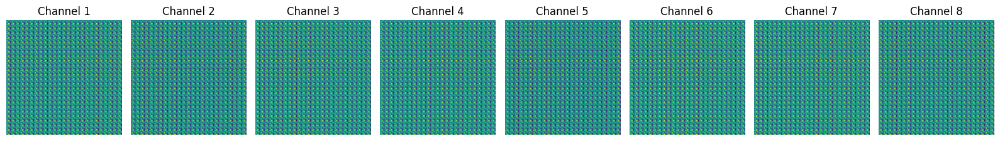

Epoch 7/40, Train Loss: 0.1573, Val Loss: 0.1451


Epoch 8/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


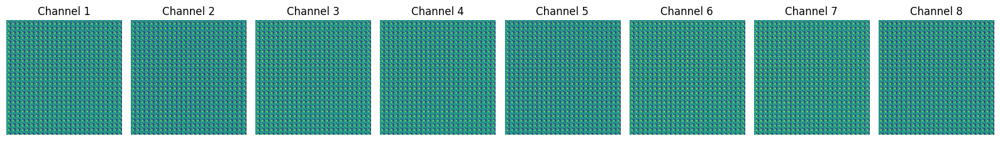

Epoch 8/40, Train Loss: 0.1342, Val Loss: 0.1247


Epoch 9/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


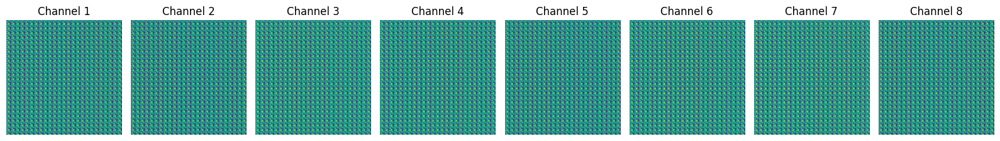

Epoch 9/40, Train Loss: 0.1159, Val Loss: 0.1084


Epoch 10/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


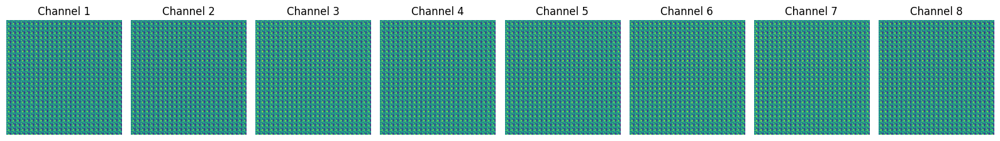

Epoch 10/40, Train Loss: 0.1012, Val Loss: 0.0953


Epoch 11/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.34s/batch]


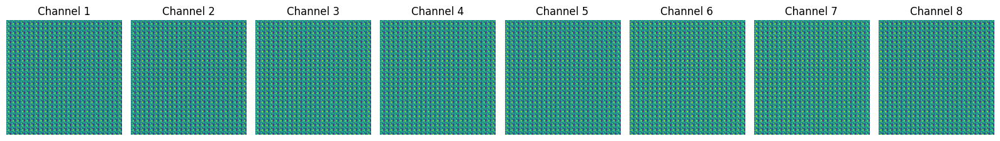

Epoch 11/40, Train Loss: 0.0893, Val Loss: 0.0847


Epoch 12/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


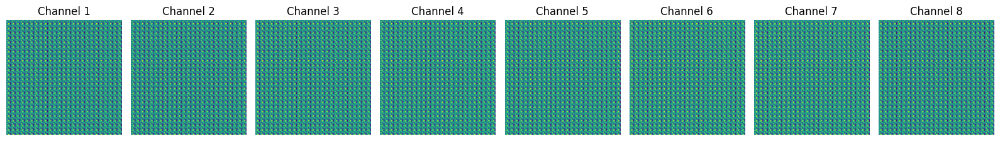

Epoch 12/40, Train Loss: 0.0797, Val Loss: 0.0761


Epoch 13/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


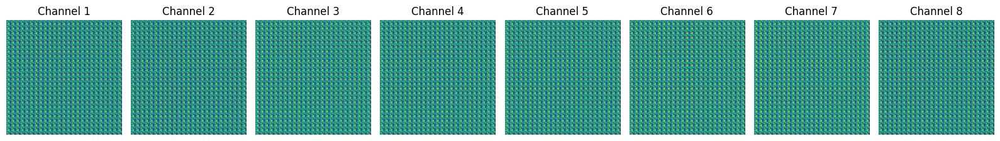

Epoch 13/40, Train Loss: 0.0719, Val Loss: 0.0690


Epoch 14/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


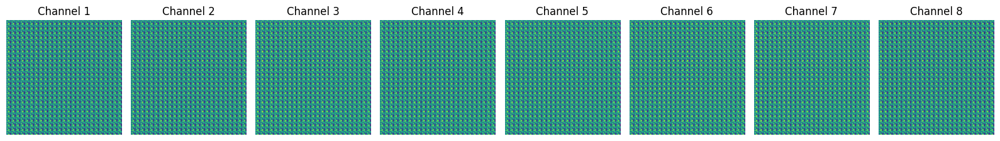

Epoch 14/40, Train Loss: 0.0654, Val Loss: 0.0632


Epoch 15/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


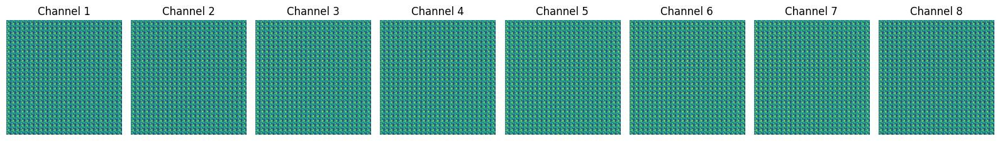

Epoch 15/40, Train Loss: 0.0600, Val Loss: 0.0584


Epoch 16/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.34s/batch]


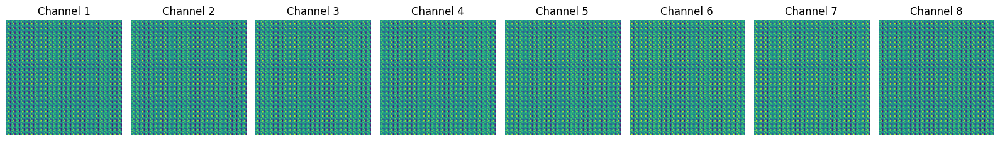

Epoch 16/40, Train Loss: 0.0556, Val Loss: 0.0543


Epoch 17/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


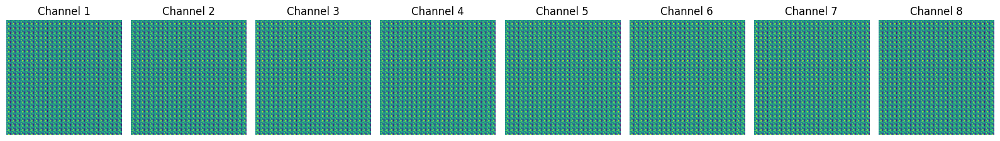

Epoch 17/40, Train Loss: 0.0518, Val Loss: 0.0509


Epoch 18/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


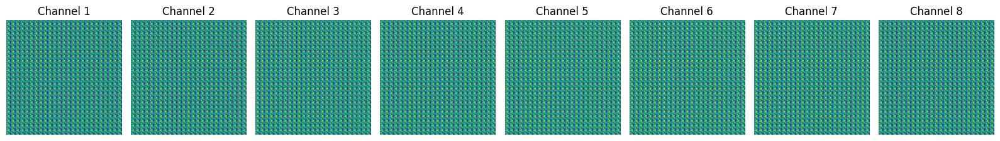

Epoch 18/40, Train Loss: 0.0486, Val Loss: 0.0480


Epoch 19/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


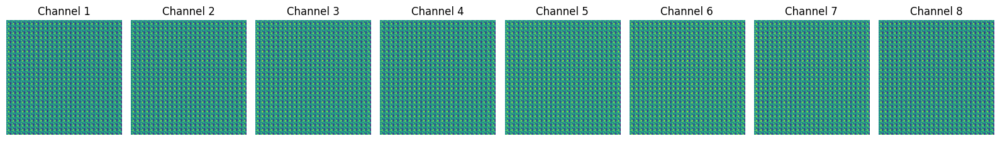

Epoch 19/40, Train Loss: 0.0459, Val Loss: 0.0455


Epoch 20/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


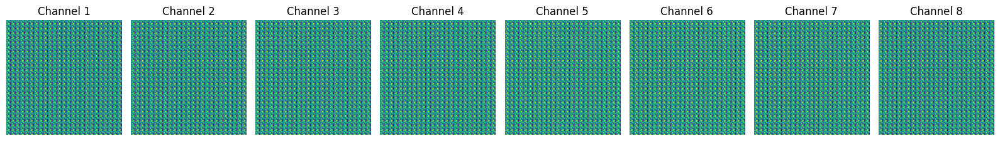

Epoch 20/40, Train Loss: 0.0437, Val Loss: 0.0435


Epoch 21/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


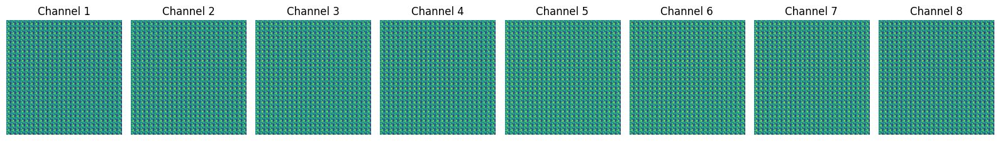

Epoch 21/40, Train Loss: 0.0417, Val Loss: 0.0417


Epoch 22/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


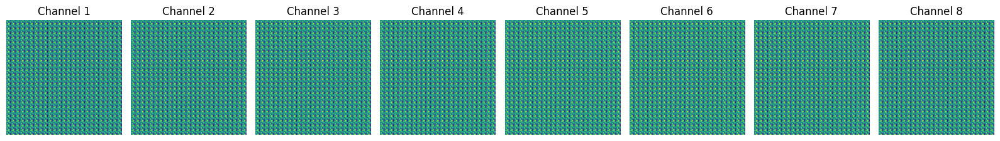

Epoch 22/40, Train Loss: 0.0400, Val Loss: 0.0401


Epoch 23/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.34s/batch]


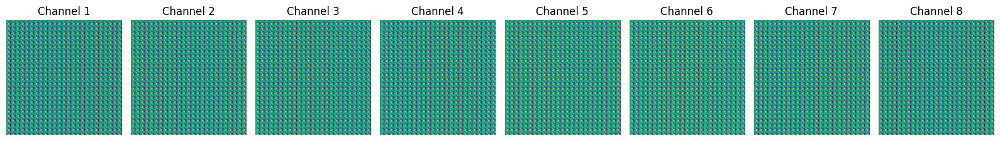

Epoch 23/40, Train Loss: 0.0386, Val Loss: 0.0388


Epoch 24/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


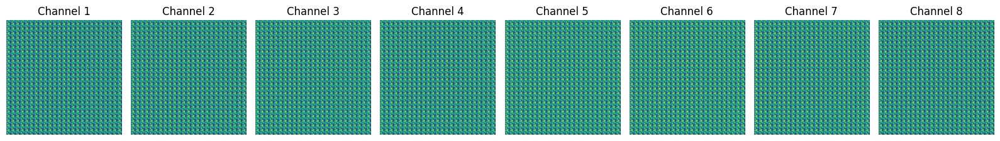

Epoch 24/40, Train Loss: 0.0374, Val Loss: 0.0377


Epoch 25/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


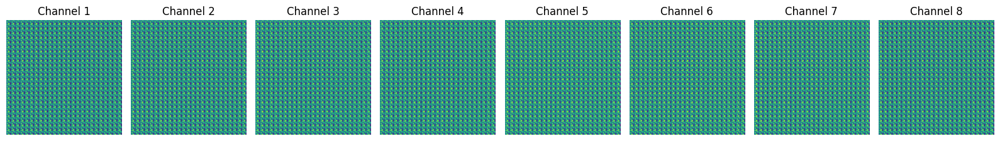

Epoch 25/40, Train Loss: 0.0363, Val Loss: 0.0367


Epoch 26/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


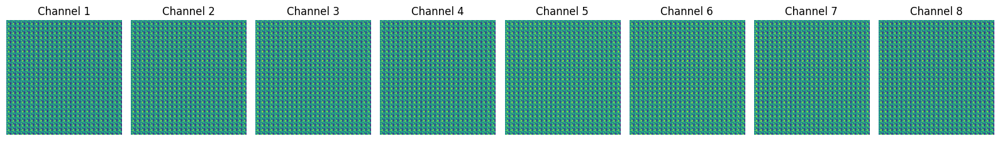

Epoch 26/40, Train Loss: 0.0354, Val Loss: 0.0359


Epoch 27/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


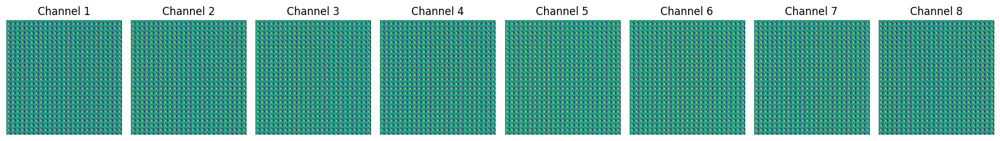

Epoch 27/40, Train Loss: 0.0346, Val Loss: 0.0352


Epoch 28/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


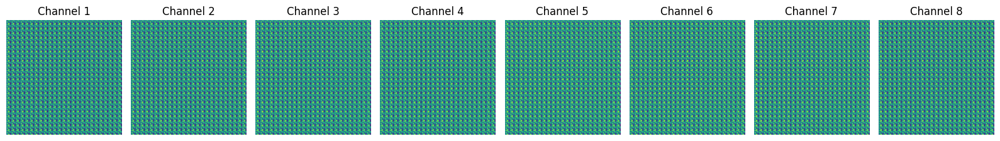

Epoch 28/40, Train Loss: 0.0339, Val Loss: 0.0346


Epoch 29/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


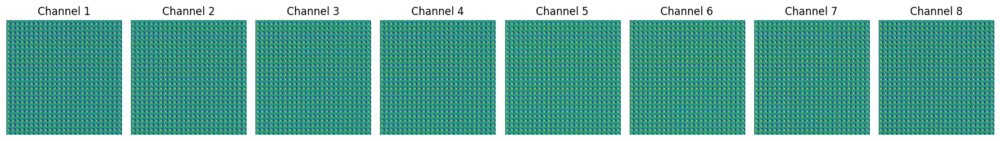

Epoch 29/40, Train Loss: 0.0334, Val Loss: 0.0341


Epoch 30/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


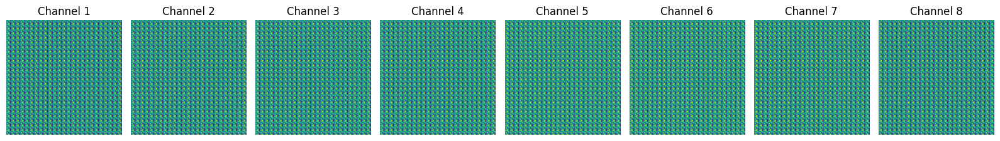

Epoch 30/40, Train Loss: 0.0329, Val Loss: 0.0336


Epoch 31/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


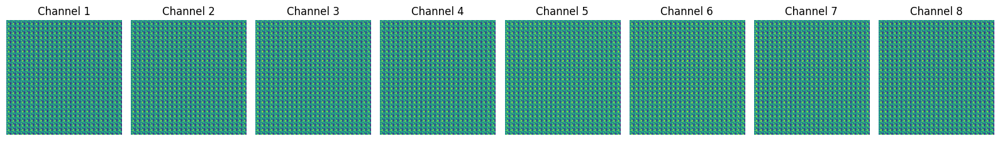

Epoch 31/40, Train Loss: 0.0325, Val Loss: 0.0333


Epoch 32/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


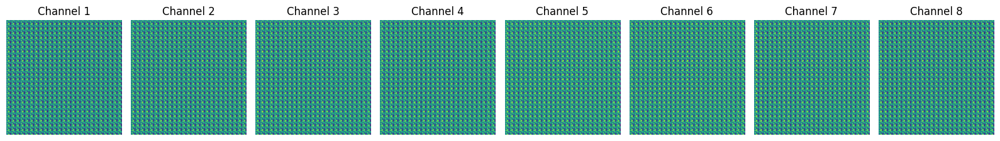

Epoch 32/40, Train Loss: 0.0322, Val Loss: 0.0330


Epoch 33/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


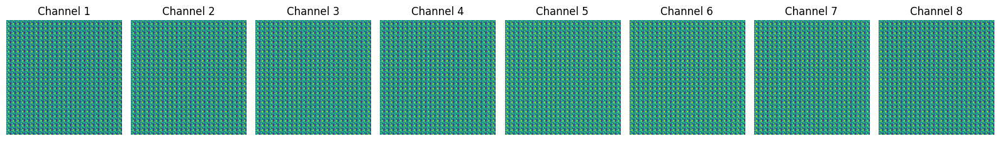

Epoch 33/40, Train Loss: 0.0319, Val Loss: 0.0327


Epoch 34/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


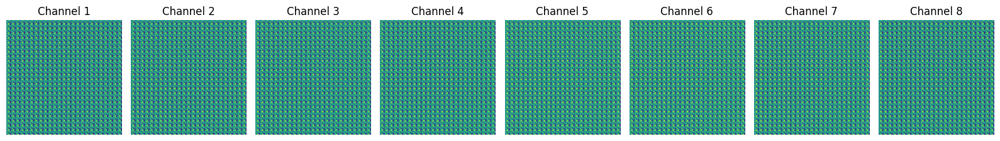

Epoch 34/40, Train Loss: 0.0317, Val Loss: 0.0326


Epoch 35/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


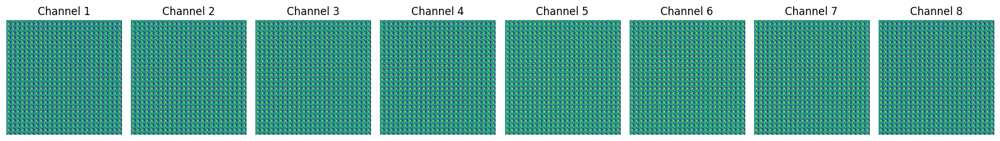

Epoch 35/40, Train Loss: 0.0315, Val Loss: 0.0324


Epoch 36/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


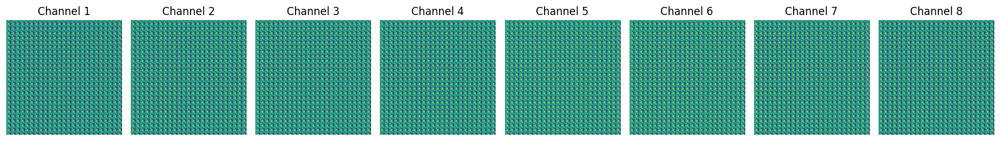

Epoch 36/40, Train Loss: 0.0314, Val Loss: 0.0323


Epoch 37/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


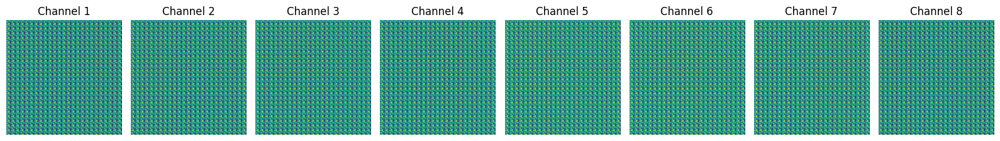

Epoch 37/40, Train Loss: 0.0313, Val Loss: 0.0323


Epoch 38/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.33s/batch]


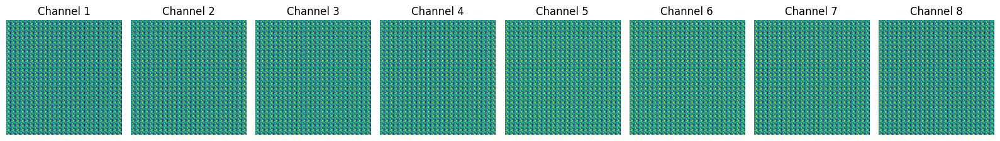

Epoch 38/40, Train Loss: 0.0313, Val Loss: 0.0322


Epoch 39/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


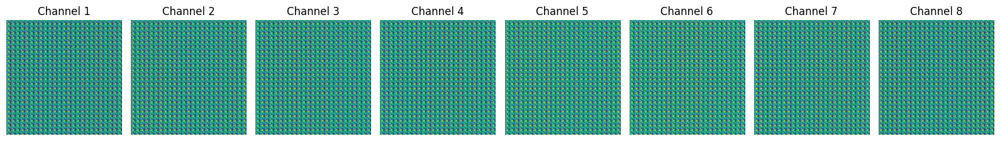

Epoch 39/40, Train Loss: 0.0313, Val Loss: 0.0322


Epoch 40/40 (Val): 100%|██████████| 16/16 [00:37<00:00,  2.32s/batch]


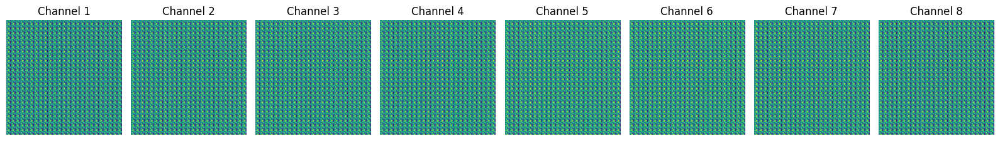

Epoch 40/40, Train Loss: 0.0313, Val Loss: 0.0322


In [19]:
train_losses, val_losses = model_train(model, 40, train_dataloader, val_dataloader, DEVICE)

In [20]:
encoder = model.module.encoder

In [21]:
torch.save(encoder, 'encoder.pth')

In [22]:
torch.save(model.module, 'model.pth')

torch.Size([8, 125, 125])


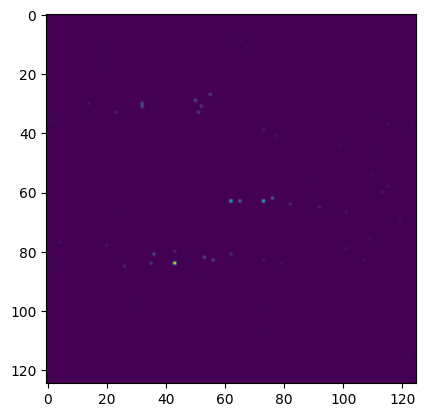

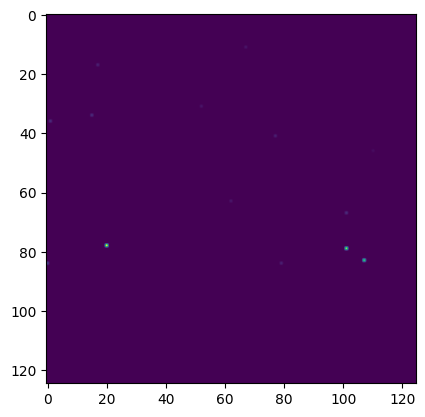

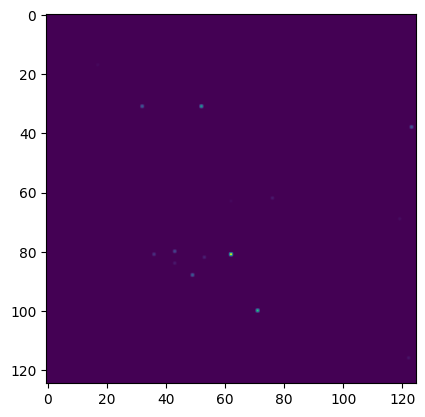

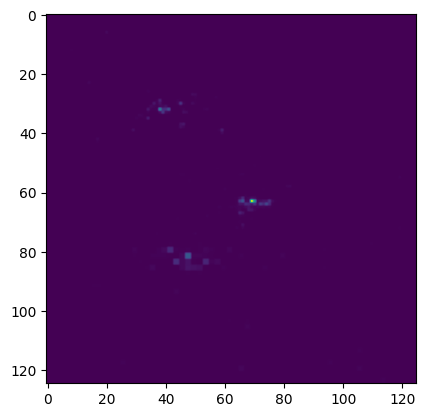

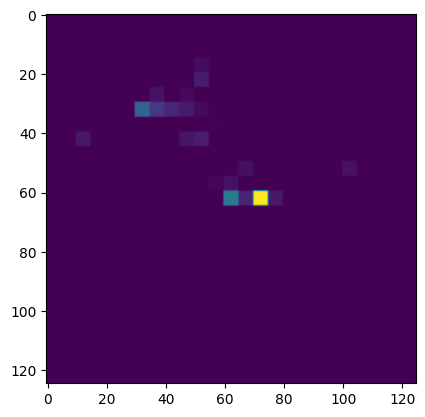

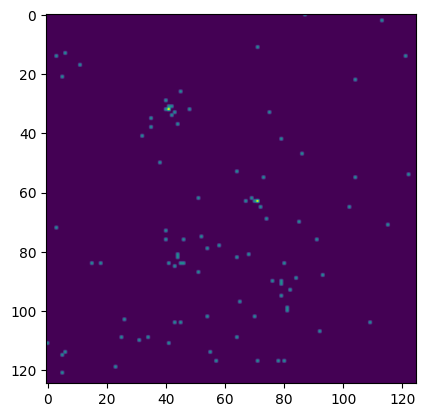

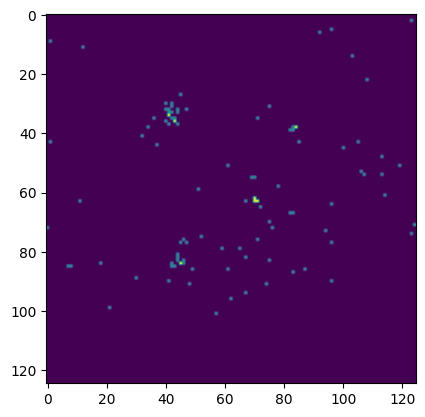

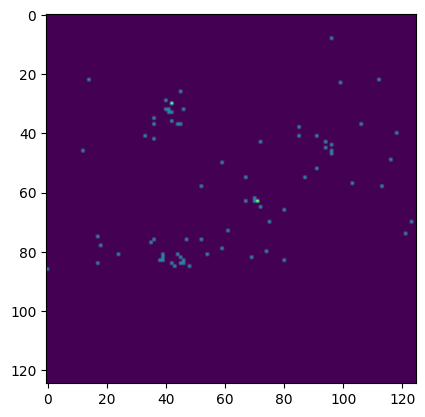

In [23]:
# !pip install torchviz
sample = test_dataset.__getitem__(0)
print((sample['img']).shape)

img = sample['img'].permute(1,2,0)
img = img.cpu().detach().numpy()
# print(img.max())
img = img*255.0
import matplotlib.pyplot as plt
for i in range(8):
    plt.imshow(img[:,:,i])
    plt.show()

In [24]:
pred, ind, imgs = model(sample['img'].unsqueeze(0))

pred.shape

def unpatchify(x):
    """
    x: (N, L, patch_size**2 *3)
    imgs: (N, 8, H, W)
    """
    p = 5
    h = w = int(x.shape[1]**.5)
    assert h * w == x.shape[1]
    
    x = x.reshape(shape=(x.shape[0], h, w, p, p, 8))
    x = torch.einsum('nhwpqc->nchpwq', x)
    imgs = x.reshape(shape=(x.shape[0], 8, h * p, h * p))
    return imgs

# pred = pred.reshape((125,125,8))
pred = unpatchify(pred)
pred.shape
pred = pred.reshape((8, 125, 125))
pred.shape

img = pred.permute(1,2,0)
img = img.cpu().detach().numpy()

import matplotlib.pyplot as plt
for i in range(8):
    plt.imshow(img[:,:,i])
    plt.show()

ValueError: not enough values to unpack (expected 3, got 2)

In [ ]:
import matplotlib.pyplot as plt
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# pred, mask, imgs = model(sample['img'].unsqueeze(0).to('cuda'))

# pred.shape

# def unpatchify(x):
#     """
#     x: (N, L, patch_size**2 *3)
#     imgs: (N, 8, H, W)
#     """
#     p = 5
#     h = w = int(x.shape[1]**.5)
#     assert h * w == x.shape[1]
    
#     x = x.reshape(shape=(x.shape[0], h, w, p, p, 8))
#     x = torch.einsum('nhwpqc->nchpwq', x)
#     imgs = x.reshape(shape=(x.shape[0], 8, h * p, h * p))
#     return imgs

# # pred = pred.reshape((125,125,8))
# pred = unpatchify(pred)
# pred.shape
# pred = pred.reshape((8, 125, 125))
# pred.shape

# img = pred.permute(1,2,0)
# img = img.cpu().detach().numpy()

# import matplotlib.pyplot as plt
# for i in range(8):
#     plt.imshow(img[:,:,i])
#     plt.show()